# Kolmogorov-Smirnov Point Estimate Statistic for Speech Chirpiness

In [1]:
import Pkg
Pkg.activate("..")
import WCA1

 Activating environment at `/mnt/data/L2S/myWCA1/Project.toml`
┌ Info: Precompiling WCA1 [f15acf5a-a3df-11e9-3331-7bf93435fc23]
└ @ Base loading.jl:1278
┌ Warning: Package WCA1 does not have Distributions in its dependencies:
│ - If you have WCA1 checked out for development and have
│   added Distributions as a dependency but haven't updated your primary
│   environment's manifest file, try `Pkg.resolve()`.
│ - Otherwise you may need to report an issue with WCA1
└ Loading Distributions into WCA1 from project dependency, future warnings for WCA1 are suppressed.


In [5]:
import WAV
x, fs = WAV.wavread("../samples/speech_signal_example.wav")
x = vec(x);

Let's first implement the Kolmogorov-Smirnov statistic (point estimate)

In [3]:
using Distributions, StatsBase, HypothesisTests
using Glob, Plots

function ks_pt_estimate(data::Vector{T}, d::UnivariateDistribution) where T<:Real
    n = length(data)
    cdf_vals = cdf.(d, ecdf(data).sorted_values)
    pos = maximum((1:n)/n - cdf_vals)
    neg = maximum(cdf_vals - (0:n-1)/n)
    return max(pos, neg)
end

function ks_test(data::Vector{T}, d::UnivariateDistribution; α=0.95) where T<:Real
    ks_stat = sqrt(length(data)) * ks_pt_estimate(data, d)
    return !(ks_stat > cdf(Kolmogorov(), α))
end

ks_test (generic function with 1 method)

In [4]:
cauchy_median(data) = Cauchy(median(data), median(abs.(data)))
cauchy_iqr(data) = Cauchy(median(data), percentile(data, 75) - percentile(data, 25)/2)
cauchy_mle(data) = fit(Cauchy, data)

cauchy_mle (generic function with 1 method)

Implement a function that compares the point estimates for different STFT parameters and Cauchy estimators

In [6]:
function ks_params_pte(x::Vector{T}, fs, nperseg, overlap) where T<:Real
    pte = zeros(length(nperseg), length(overlap), 2, 2)
    pte_index = similar(pte, Any)
    win = [WCA1.hanning, nothing]
    dfunc = [cauchy_median, cauchy_iqr]
    #for width in nperseg, ratio in overlap, win in [WCA1.hanning, nothing], dfunc in [cauchy_median, cauchy_iqr]
    for i in eachindex(nperseg), j in eachindex(overlap), k in eachindex(win), d in eachindex(dfunc)
        noverlap = round(Int, overlap[j] * nperseg[i])
        X = WCA1.stft(x, nperseg[i], noverlap; fs=fs, window=win[k])
        ν = vec(WCA1.brdcast_chirpiness(X))
        pte[i,j,k,d] = ks_pt_estimate(ν, dfunc[d](ν))
        pte_index[i,j,k,d] =
        pte_index[i,j,k,d] = (
            width = nperseg[i],
            overlap = overlap[j],
            window = win[k],
            distribution = dfunc[d],
        )
    end
    return pte, pte_index
end

ks_params_pte (generic function with 1 method)

We test for different values of FFT window lengths and overlap ratios

In [10]:
nperseg = [250, 500, 1000, 1500, 2000, 5000, 10000]
overlap = [1//2, 2//3, 3//4, 4//5, 9//10];

In [11]:
pte, pte_index = ks_params_pte(x, fs, nperseg, overlap);

In [12]:
val, arg = findmin(pte)
println("minimum point estimate:\t", val)
println("attained at:\t", pte_index[arg])

minimum point estimate:	0.003492509704383029
attained at:	(width = 500, overlap = 4//5, window = DSP.Windows.hanning, distribution = cauchy_median)


In [30]:
function plot_pte(pte, nperseg) where T<:Real
    plot(nperseg, vec(minimum(pte, dims=(2,3,4))),
        xaxis="FFT Width (samples)", yaxis="KS point estimate", legend=false)
end

function plot_pte(pte, nperseg, overlap) where T<:Real
    heatmap(nperseg, overlap, reshape(minimum(pte, dims=(3,4)), length(nperseg), length(overlap)),
        xaxis="FFT Width (samples)", yaxis="Overlap ratio [0,1)")
end

plot_pte (generic function with 2 methods)

Heatmap of minimum point estimate with respect to FFT width and overlap ratios

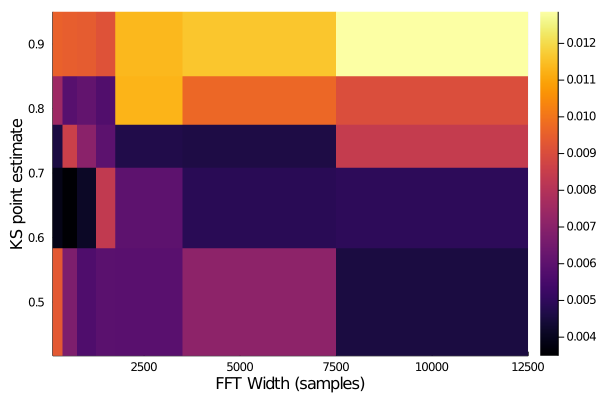

In [14]:
plot_pte(pte, nperseg, overlap)

Plot of minimum point estimate with respect to FFT widths

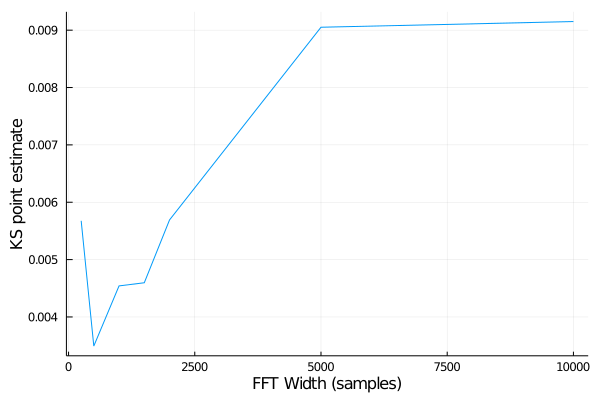

In [15]:
plot_pte(pte, nperseg)

We postulate that the point estimate for the Cauchy median estimator is *always* lower than that for the half IQR estimator

In [16]:
all(pte[:,:,:,1] .<= pte[:,:,:,2])

true

The hypothesis is true for all tested values of FFT width, overlap, and window type.
Let's now test that the point estimate is lower for the Hann window than that of the rectangular window.

In [18]:
pte[:,:,1,1] .<= pte[:,:,2,1]

7×5 BitArray{2}:
 1  1  1  1  1
 1  1  1  1  1
 1  1  1  1  1
 1  1  1  1  1
 1  1  1  1  1
 0  1  1  1  1
 0  1  1  1  1

The hypothesis is true for most values except for extremely large windows with overlap ratio 1/2.

Let's now apply the KS test for the minimum point estimate.

In [23]:
# use best paramaters to calculate stft and chirpiness
width = pte_index[arg].width
noverlap = round(Int, pte_index[arg].overlap * width)
window = pte_index[arg].window
X = WCA1.stft(x, width, noverlap; fs=fs, window=window)
ν = vec(WCA1.compute_slopes(X))
d = pte_index[arg].distribution(ν)
ks_test(ν, d; α=0.95)

false

In [24]:
ExactOneSampleKSTest(ν, d)

┌ Warning: This test is inaccurate with ties
└ @ HypothesisTests /home/rand/.julia/packages/HypothesisTests/JapDD/src/kolmogorov_smirnov.jl:68


Exact one sample Kolmogorov-Smirnov test
----------------------------------------
Population details:
    parameter of interest:   Supremum of CDF differences
    value under h_0:         0.0
    point estimate:          0.00349251

Test summary:
    outcome with 95% confidence: reject h_0
    two-sided p-value:           0.0002

Details:
    number of observations:   385536


The test rejects the $H_0$ hypothesis for the lowest point estimate. Let's plot the PDF and CDF to visualise the goodness-of-fit anyway.

In [25]:
import LinearAlgebra
histo(data, nbins=Int(ceil(sqrt(length(data))))) = fit(Histogram, data; closed=:right, nbins=nbins)
mid_range(bins) = first(bins)+0.5*step(bins):step(bins):last(bins)-0.5*step(bins)

function plot_histogram_pdf(data::Vector{T}, d::D, nbins::Int=Int(ceil(sqrt(length(data))));
            lims=WCA1.auto_cut(data; p=0.99)) where {T<:Real, D<:UnivariateDistribution}
    hdata = (lims === nothing) ? data : data[lims[1] .<= data .<= lims[2]]
    h = histo(hdata, nbins)
    mid_bins = mid_range(h.edges[1])
    plot(LinearAlgebra.normalize(h, mode=:pdf), label="normalized histogram")
    plot!(mid_bins, pdf.(d, mid_bins), color="red", label="probability distribution function")
end

function plot_data_cdf(data::Vector{T}, d::D;
            lims=WCA1.auto_cut(data; p=0.99)) where {T<:Real, D<:UnivariateDistribution}
    sorted = ecdf(data).sorted_values
    plot(sorted, range(0, stop=1, length=length(sorted)), label="empirical distribution function", legend=:bottomright)
    plot!(sorted, cdf.(d, sorted), color="red", label="cumulative distribution function")
    if lims !== nothing; xlims!(lims) end
end

plot_data_cdf (generic function with 1 method)

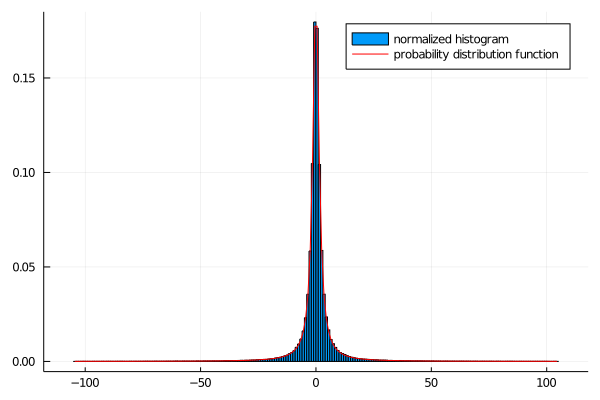

In [26]:
plot_histogram_pdf(ν, d, 200)

In [27]:
plot_data_cdf(ν, d)

The distribution seems to fit visually, let's plot the absolute difference between the empirical function and the CDF to see the points that fit the most/least.

In [29]:
sorted = ecdf(ν).sorted_values
ν_diff = abs.(range(0, stop=1, length=length(sorted)) - cdf.(d, sorted))
plot(sorted, ν_diff, label="empirical absolute difference")

In [35]:
plot(sorted, ν_diff, label="empirical absolute difference")
xlims!(WCA1.auto_cut(ν; p=0.99))

In [37]:
plot(sorted, ν_diff, label="empirical absolute difference")
xlims!(WCA1.auto_cut(ν; p=0.999))

As we can see, the highest mismatches occur around the median.
We had previously postulated that the mismatches are higher at the tails, we can justify that by the fact that we used to plot the **cut** chirpiness at the **imposed** interval *then* evaluate the distribution which is however inconsistent with the pipeline that evaluates the distribution in order to compute a confidence interval.
Indeed, the empirical function always starts at 0 and ends at 1 *at the studied interval* (by definition) while the CDF has the same properties at the limit $(-\infty,\infty)$ and would mismatch therefore at any small finite interval.